In Docker Hub, all items are ima ges, not containers.

In [ ]:
# Pull image from Docker Hub
docker pull redis

In [ ]:
# Check available images
docker images

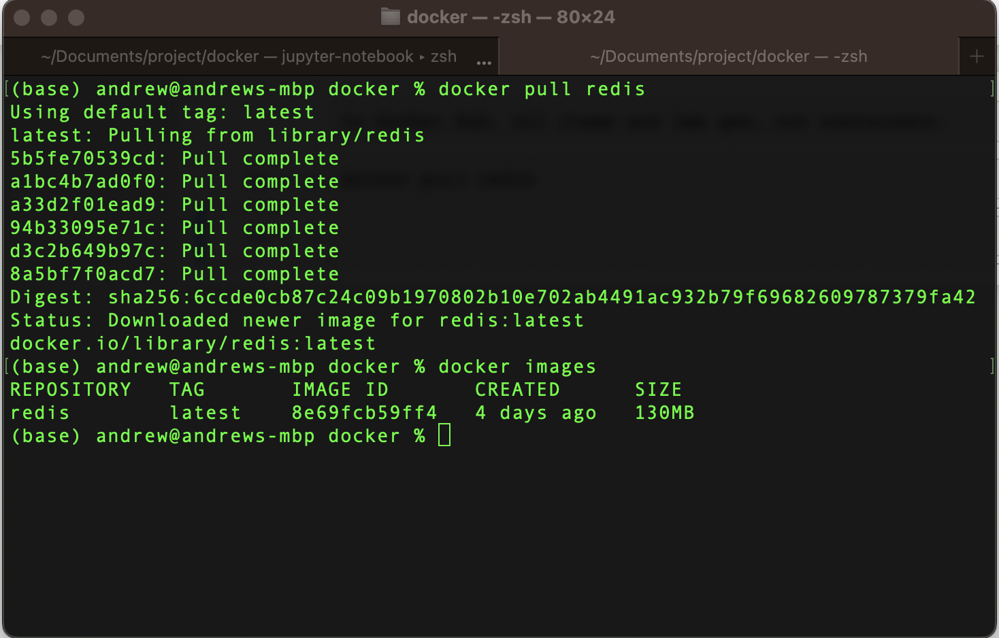

In [ ]:
# Create a container from image in attached mode
docker run redis

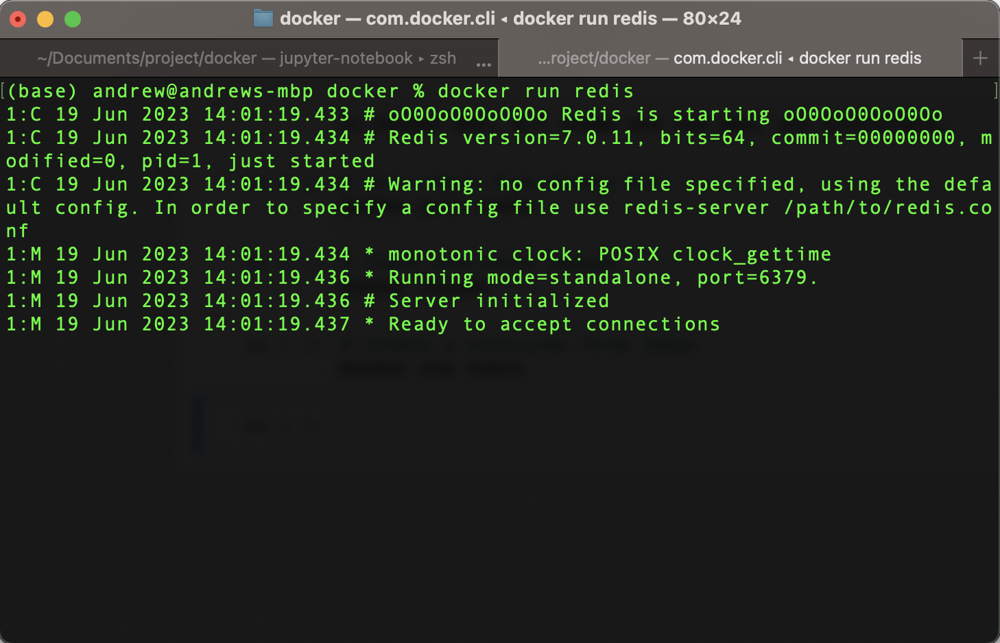

In [ ]:
# List running containers
docker ps

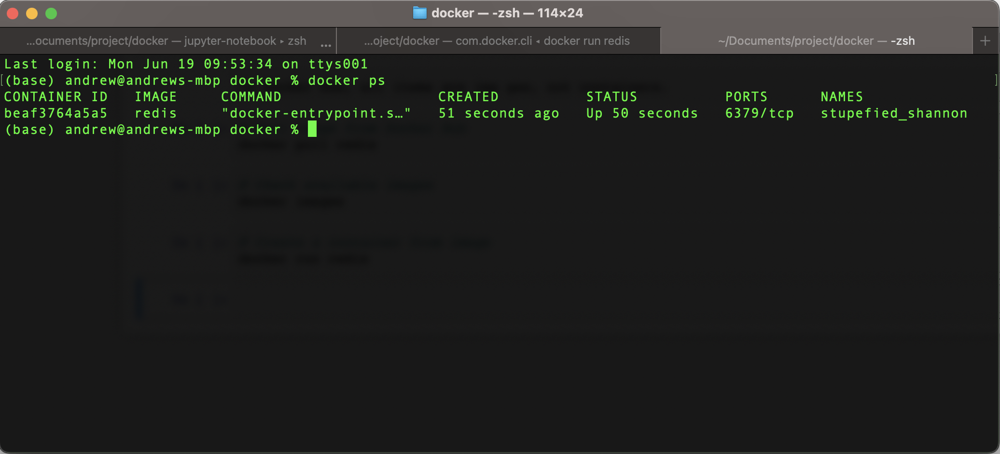

In attached mode, pressing 'Ctrl' + 'C' in ther terminal running the docker container will the container to stop.
Pressing docker ps will show nothing

In [ ]:
# Run in detached mode
docker run -d redis

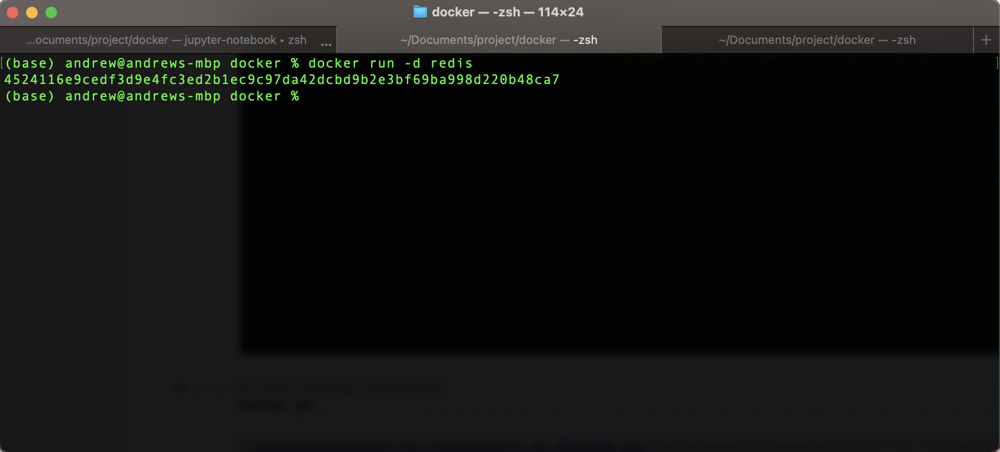

In [ ]:
# Stop the detached container in detached mode using the first few digits of container ID
docker stop 4524116e9ced

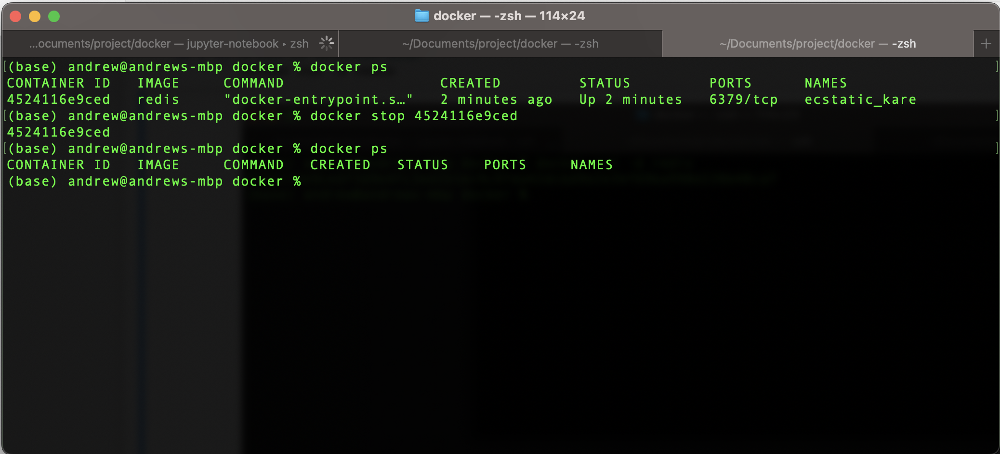

In [ ]:
# Restart stopped container
docker start 4524116e9ced

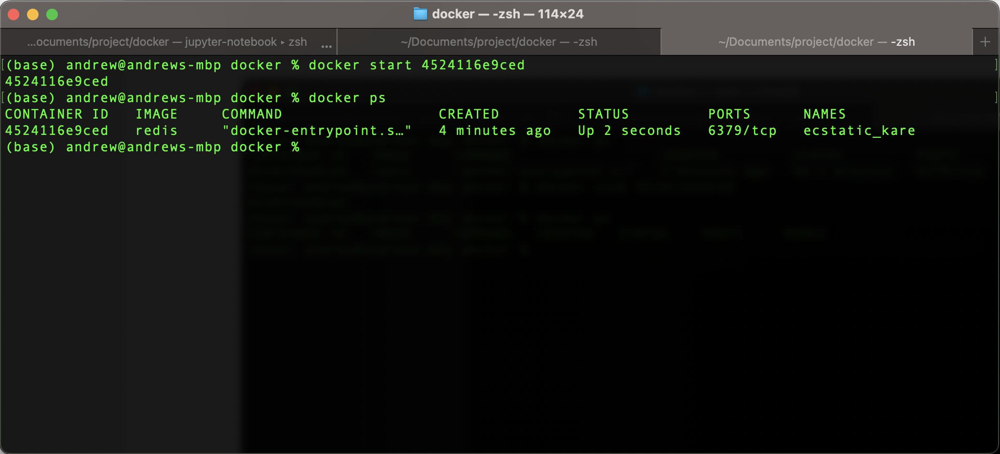

In [ ]:
# To rerun containers closed overnight
# Show all containers running or not running
docker ps -a

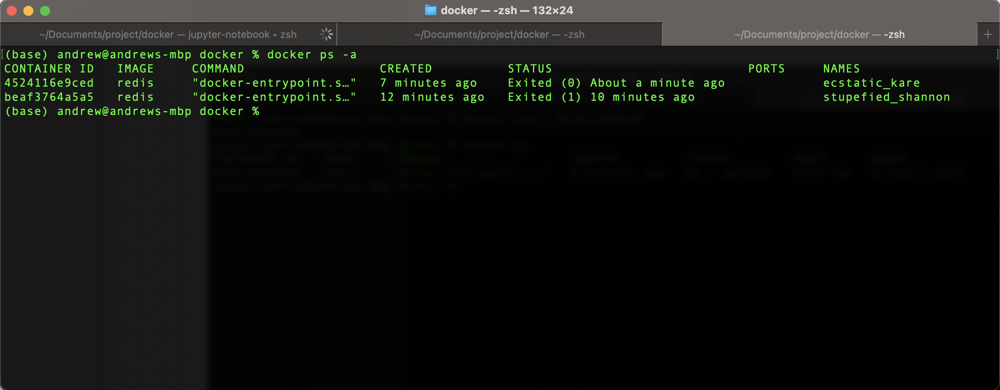

In [ ]:
# Automatically pull and run a container of an image of a specific version of software
docker run redis:4.0

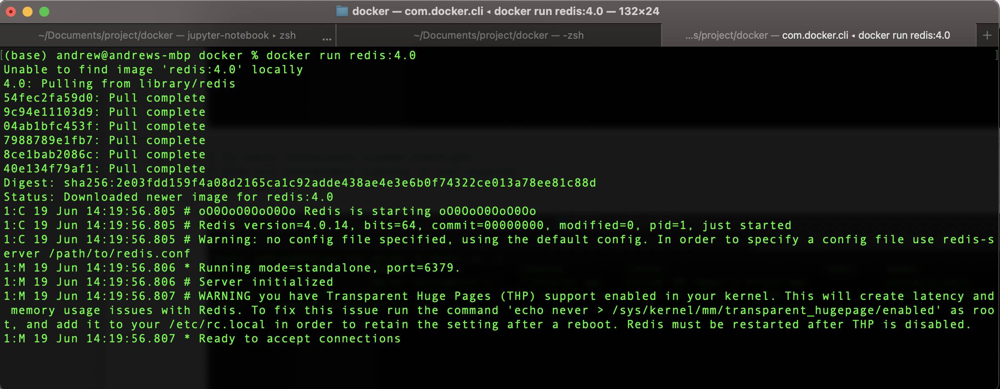

In [ ]:
# Both containers running the same port
docker ps -a

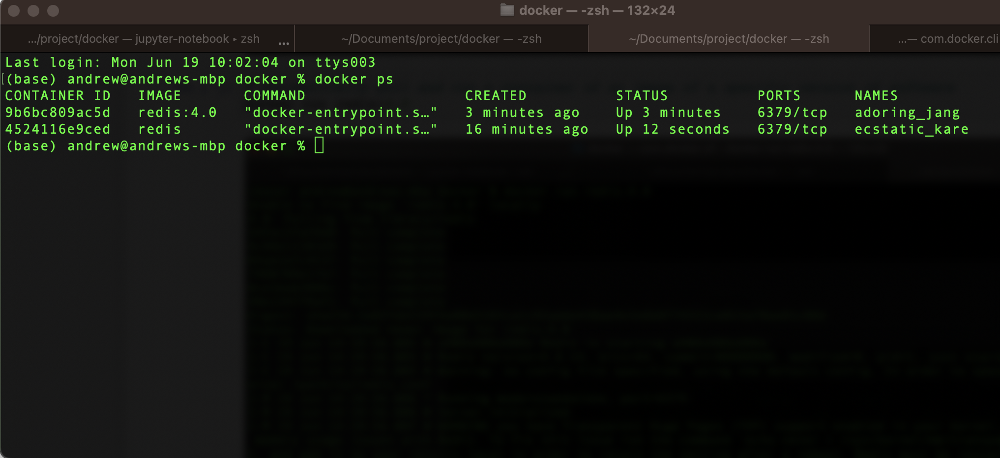

multiple containers running on host machine
laptop only has certain ports available
conflict when running two same ports on host
using port binding, the host will know how to forward request to the container port

In [ ]:
# specify port binding in creation of container
docker run -p6000:6379 -d redis
# where 6000 is the specified port on local host and 6379 is the container port

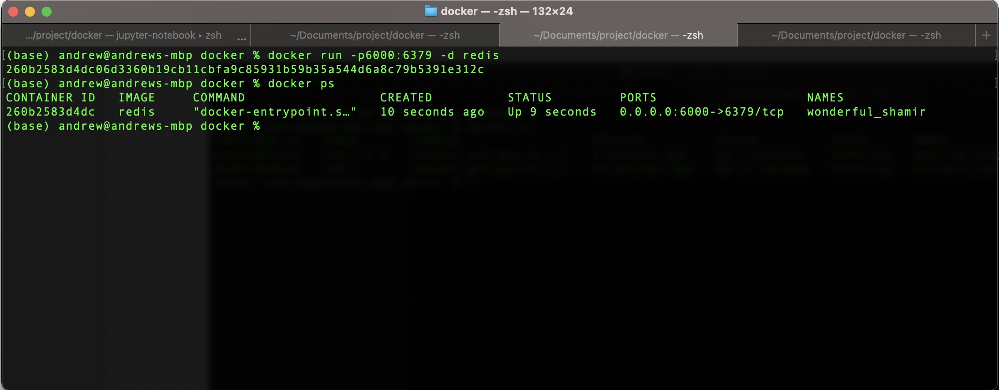

In [ ]:
# Trying to run another container in the same port on local host will cause an error to appear
docker run -p6000:6379 -d redis:4.0

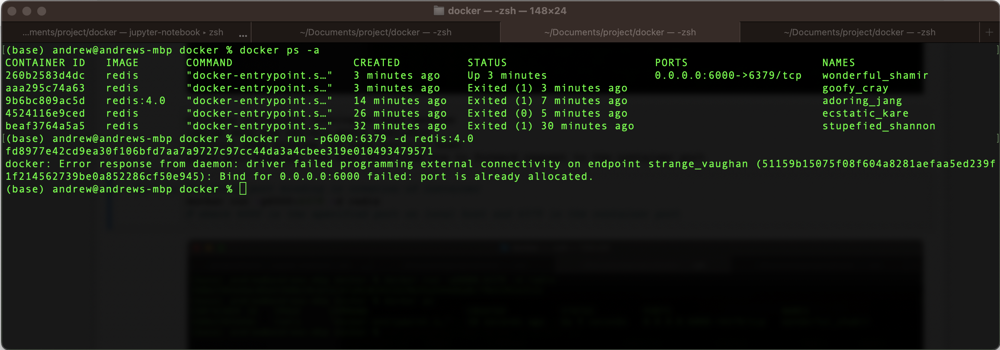

In [ ]:
# Specify port 6001 on local host
docker run -p6001:6379 -d redis:4.0

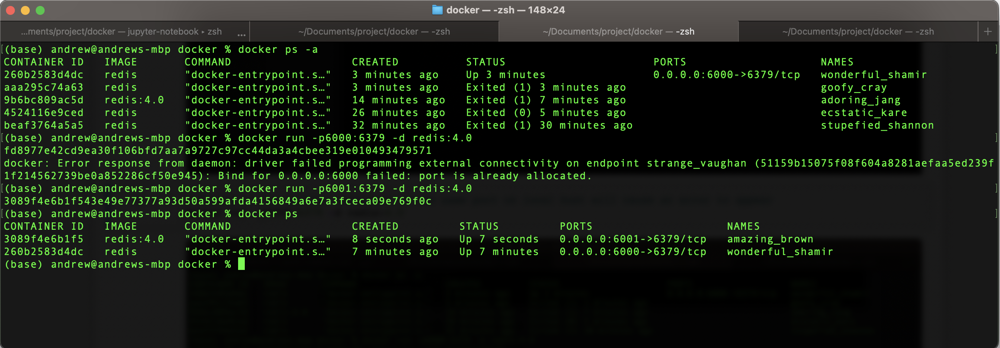

# Debugging containers

In [ ]:
# get logs
docker logs 3089f4e6b1f5
# or
docker logs amazing_brown

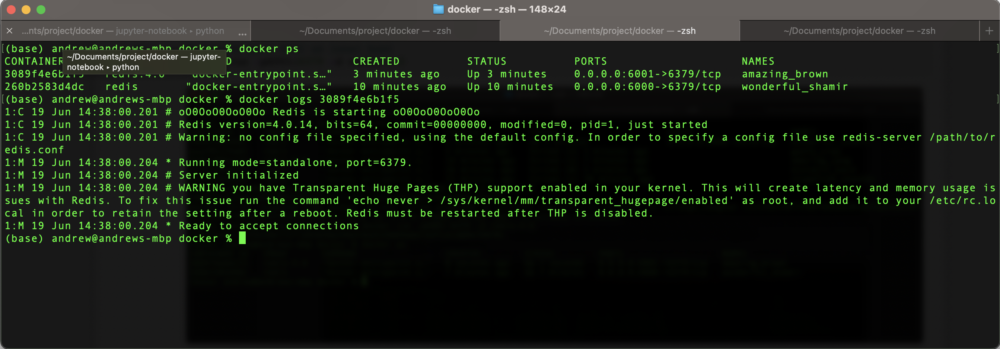

In [ ]:
# Create image with specified name
docker run -d -p6001:6379 --name redis-older redis:4.0

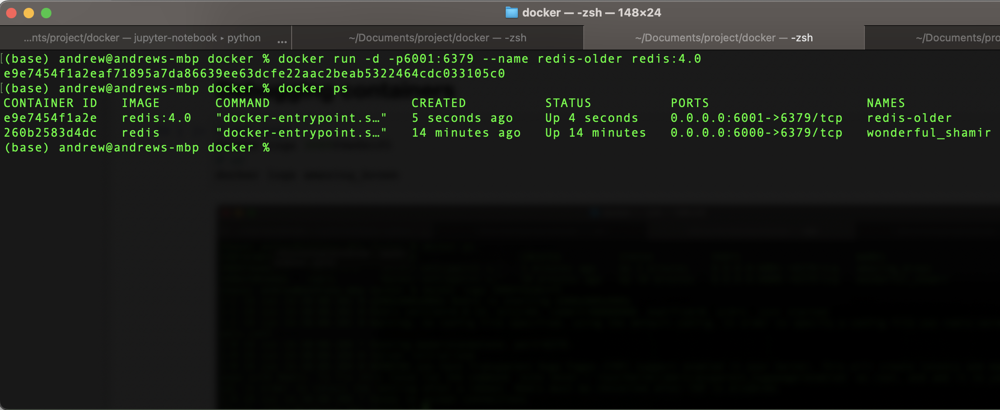

In [ ]:
# Enter terminal within running container
docker exec -it redis-older /bin/bash
# -it interactive terminal
# bash

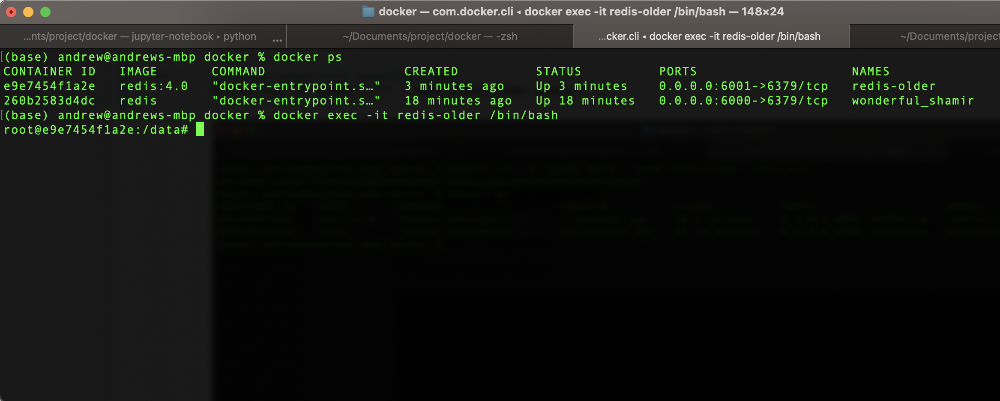

In [ ]:
# running your own application in your own container

exit # to exit
# basic linux, no curl

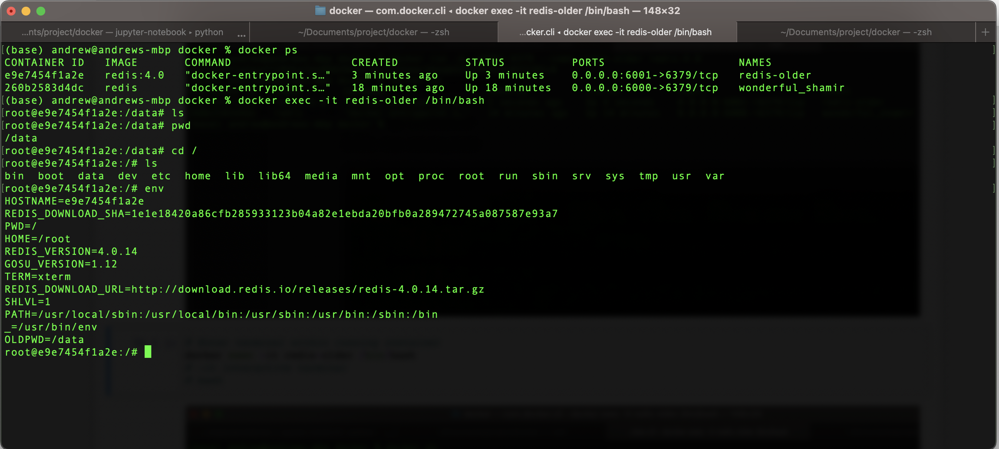

# Docker used in practice

docker network : deploy two containers within a network, communicate without the need of local host

In [ ]:
# Check available docker networks
docker network ls

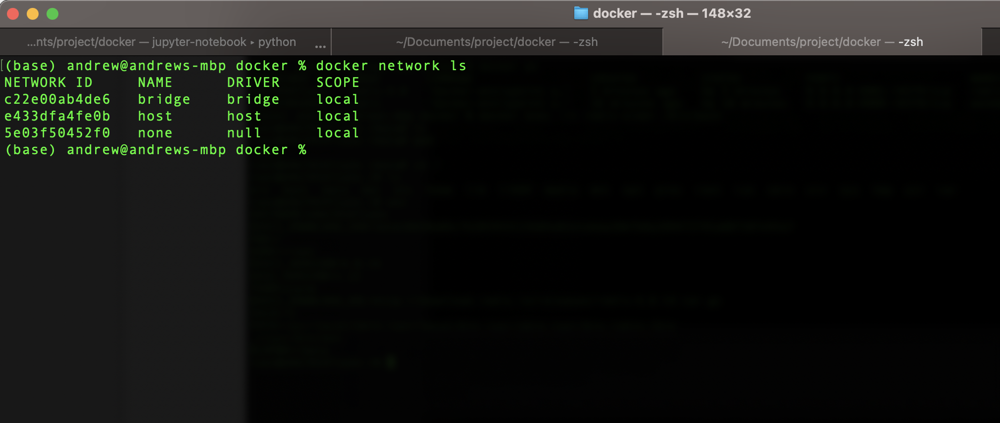

In [ ]:
# Create docker network
docker network create mongo-network

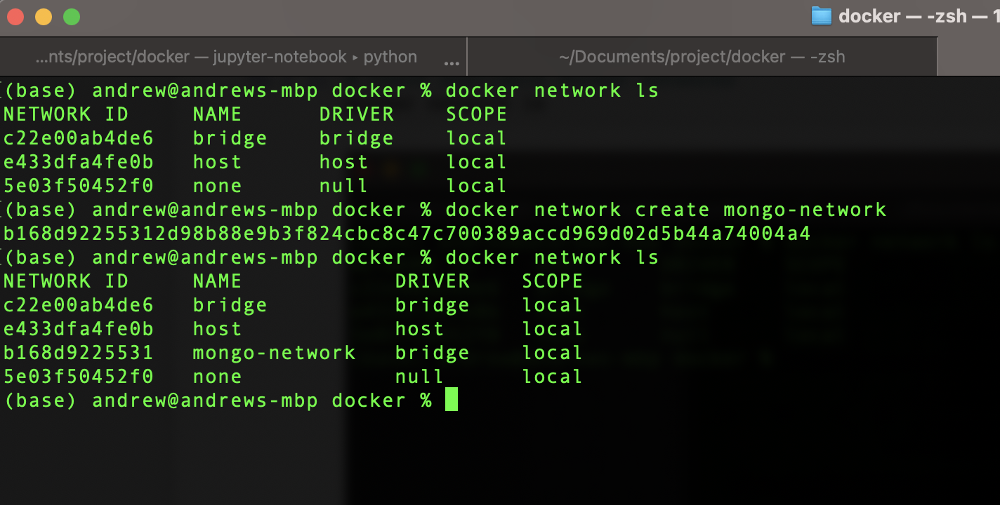

In [ ]:
# running a container within the docker network
docker run -d \
-p 27017:27017 \
-e MONGO_INITDB_ROOT_USERNAME=admin \
-e MONGO_INITDB_ROOT_PASSWORD=password \
--name mongodb \
--net mongo-network \
mongo

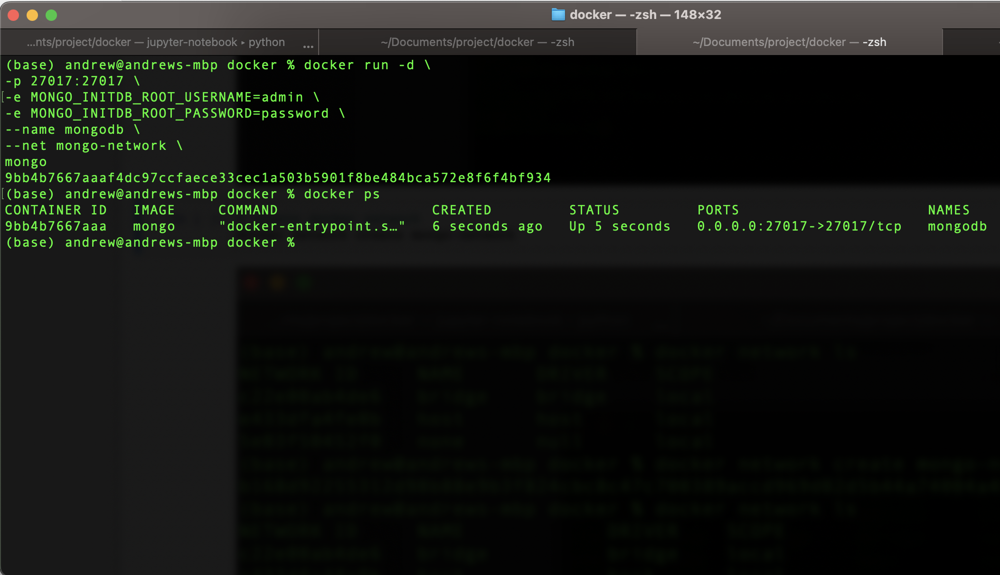

In [ ]:
# We want mongo express to connect to the running mongodb container on startup
docker run -d \
-p 8081:8081 \
-e ME_CONFIG_MONGODB_ADMINUSERNAME=admin \
-e ME_CONFIG_MONGODB_ADMINPASSWORD=password \
--net mongo-network \
--name mongo-express \
-e ME_CONFIG_MONGODB_SERVER = mongodb \
mongo-express

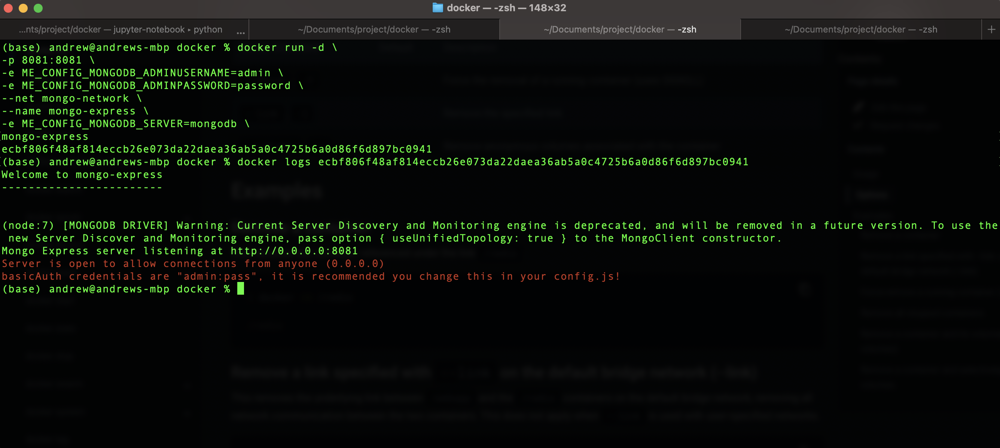

In [ ]:
docker logs container_name | tail
docker logs container_name -f

# Docker Compose